In [1]:
### Load necessary modules -------------------------------
# interactive plotting
%matplotlib inline
%config InlineBackend.figure_format = 'svg' # ‘png’, ‘retina’, ‘jpeg’, ‘svg’, ‘pdf’

# plotting libraries
import seaborn as sns
import matplotlib.pyplot as plt
sns.set()
sns.set_theme()

# Data management libraries
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import math
import os

# Machine learning libraries
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder, PolynomialFeatures
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.compose import ColumnTransformer
from scipy.stats import norm
from sklearn.metrics import accuracy_score
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from neuralsens import partial_derivatives as ns

#Clustering
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.cluster.vq import vq
from sklearn.metrics import silhouette_score
import skfuzzy as fuzz
from skfuzzy import cmeans
from sklearn_extra.cluster import KMedoids
from sklearn.metrics import pairwise_distances
from itertools import combinations

#Profiling
import line_profiler
from line_profiler import LineProfiler
%load_ext line_profiler

from funciones_limpieza import *
from utils_aprendizaje_no_supervisado import * 
from funciones_previas import *
from funciones_seriestemporales import *

In [2]:
#Convertimos los csvs a dataframes de pandas. El resultado de aplicar la función 'limpieza_csv_plotss_carpeta' es una tupla donde el primer 
#elemento es una lista de dataframes y el segundo una lista con los nombres de estos dataframes
carpeta = '/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Datos_TFMGamesa/Datos Parque MYRTLE/Plots Myrtle'
dfs_nombres_plots = limpieza_csv_plots_carpeta(carpeta)

/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  plots = pd.read_csv(nombre_csv, index_col = False, sep = ";")
/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  plots = pd.read_csv(nombre_csv, index_col = False, sep = ";")
/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  plots = pd.read_csv(nombre_csv, index_col = False, sep = ";")
/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match len

In [5]:
dataframes = dfs_nombres_plots[0]
nombres_dfs = dfs_nombres_plots[1]

In [6]:
#Función para calcular el delta de temperatura en un dataframe completo

def calculo_delta_temp_dataframe(df):
    """
    Función que dado un dataframe de la lista resultado de la función 'limpieza_csv_plots_carpeta' calcula la columna delta de temperatura para 
    cada registro

    PARÁMETROS
    ----------
    -df: uno de los dataframes de limpieza_csv_plots_carpeta(carpeta)[0]

    DEVUELVE
    --------
    -df: es el dataframe original al que se han añadido las columnas 'T_SKIIP_MIN', 'TPOT_CAB_MAX', 'T_LIQ_MIN' y 'DELTA_TEMP_AMB'
    """
    
    #Calculamos el mínimo de temperatura de los skiips. Si esta es superior o igual a 31ºC tenemos en cuenta este mínimo para el cálculo del
    #delta de temperatura. En caso contrario, tenemos que tener en cuenta las temperaturas del líquido Glicol
    df['T_SKIIP_MIN'] = df[['TBRID11', 'TBRID12', 'TBRID13', 'TBRID21', 'TBRID22', 'TBRID23']].min(axis=1) #axis=1 para que calcule el mínimo por fila

    #Calculamos el valor máximo de las temperaturas de las cabinas de bloques de potencia 1 y 2 (nos ayuda a tener una idea sobre la temperatura
    #externa)
    df['TPOT_CAB_MAX'] = df[['TCAB_POT1', 'TCAB_POT2']].max(axis=1)

    # Calculamos el valor mínimo entre las temperaturas entreda/salida del líquido Glicol (solo se usará este valor si el valor mínimo de los
    #skiips es menor que 31ºC)
    df['T_LIQ_MIN'] = df[['TCOOLINGI', 'TCOOLINGO']].min(axis=1)

    #Calculamos el delta de temperatura según el valor mínimo de los skiips
    df['DELTA_TEMP_AMB'] = np.where(
    df['T_SKIIP_MIN'] >= 31, #condición: se evalúa para cada fila del df y da como resultado una serie booleana (True o False por fila)
    df['T_SKIIP_MIN'] - df['TPOT_CAB_MAX'], #valor que se asigna a DELTA_TEMP_AMB si la condición es True
    df['T_LIQ_MIN'] - df['TPOT_CAB_MAX'] #valor que se asigna si la condición es False
    )

    return df
    

In [7]:
#Aplicamos la función 'calculo_delta_temp_dataframe' a cada dataframe de la lista dataframes
dataframes_con_delta = []
for i in range(len(dataframes)):
    df_aux = calculo_delta_temp_dataframe(dataframes[i])
    dataframes_con_delta.append(df_aux)
dataframes = dataframes_con_delta

In [8]:
#Ahora aplicamos preprocesado a los datos: eliminamos valores nulos, columnas no numéricas y realizamos normalización
scaled, scaler = preprocesado_lista_dfs(dataframes, nombres_dfs)

#Me quedo con los nombres de los df y arrays para tener trazabilidad de los datos
nombres_dfs_arrays_scaled = list(scaled.keys())
dfs_arrays_scaled = list(scaled.values())

In [9]:
#Creamos listas independientes para poder distinguir entres dataframes y arrays
nombres_dfs = []
nombres_arrays = []
dfs_plots = []
arrays_plots = []
for i in range(len(nombres_dfs_arrays_scaled)):
    nombre = nombres_dfs_arrays_scaled[i]
    datos = dfs_arrays_scaled[i]
    if "array" in nombre:
        nombres_arrays.append(nombre)
        arrays_plots.append(datos)
    else:
        nombres_dfs.append(nombre)
        dfs_plots.append(datos)

In [10]:
#Para aplicar PCA tenemos que utilizar los arrays y concatenarlos todos en un único array
array_plots = np.vstack(arrays_plots)  # Une los arrays en uno solo
array_plots.size

127005060

In [11]:
#Aplicamos PCA
pca = PCA(n_components=10, svd_solver='randomized')
X_pca = pca.fit_transform(array_plots)

In [12]:
numeric_features = dfs_plots[0].select_dtypes(include=['int64','float64']).columns.tolist()
loadings = pd.DataFrame(pca.components_.T * np.sqrt(pca.explained_variance_), columns=['PC' + str(pca + 1) for pca in range(pca.n_components)], index=numeric_features)

In [13]:
def top10_variables_contribuyentes_PCA(loadings, pca):
    """
    Función que calcula las 10 varibles que más contribuyen en cada componente principal.

    PARÁMETROS
    ----------
    -loadings: dataframe con las aportaciones de cada variable en cada PCA
    -pca: objeto de tipo PCA

    DEVUELVE
    --------
    -pca_top10_vars: es un dataframe que contiene las 10 variables que m´s han contribuido en la formación de cada PCA
    """
    # Seleccionar la columna de los loadings para la componente principal especificada
    pca_column = loadings[pca]
    # Ordenar por el valor absoluto de los loadings (de mayor a menor)
    pca_column_abs = pca_column.abs().sort_values(ascending=False)
    # Obtener las 10 variables más contribuyentes
    pca_top10 = pca_column_abs.head(10)
    # Convertir a DataFrame y restablecer el índice
    pca_top10_df = pca_top10.to_frame().reset_index()
    # Extraer solo las variables (primer columna)
    pca_top10_vars = pca_top10_df.iloc[:, 0].tolist()
    
    return pca_top10_vars

In [14]:
pc1_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC1')
pc2_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC2')
pc3_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC3')
pc4_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC4')
pc5_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC5')
pc6_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC6')
pc7_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC7')
pc8_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC8')
pc9_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC9')
pc10_top10_vars = top10_variables_contribuyentes_PCA(loadings, 'PC10')

#Guardamos esta info en un diccionario que será más visual:
top10_variables_pca = {
    'PC1': pc1_top10_vars,
    'PC2': pc2_top10_vars,
    'PC3': pc3_top10_vars,
    'PC4': pc4_top10_vars,
    'PC5': pc5_top10_vars,
    'PC6': pc6_top10_vars,
    'PC7': pc7_top10_vars,
    'PC8': pc8_top10_vars,
    'PC9': pc9_top10_vars,
    'PC10': pc10_top10_vars,
}

# Crear el DataFrame
top10_variables_pca_df = pd.DataFrame(top10_variables_pca)
#top10_variables_pca_df

# Análisis de las 10 variables que más aportan a las componentes PC1, PC2, PC3

In [13]:
#Lo primero de todo va a ser juntar todos los dataframes de plots en uno solo. Vamos a usar la lista de dataframes a los que todavía no les 
#hemos aplicado normalización para poder ver las distribuciones reales y obtener una información más precisa
df_plots = pd.concat(dataframes, ignore_index=True) 
#df_plots.head(5)

In [14]:
df_plots.describe().T

#----
#PC1: ['TBRID11', 'TBRID22', 'TBRID12', 'T_SKIIP_MIN', 'TBRID23', 'TBRID13', 'TBRID21', 'TCOILIND2', 'TCOILIND1', 'TCOOLINGO']
#----
#-Las variables TBRID11,...,TBRID23 tienen distribuciones bastante parecidas. Los rangos de sus valores no están muy dispersos a excepción de
#TBRID22 en el que su tercer cuartil (59.920265) y el máximo (80.631229) si que difieren bastante en su valor lo que lleva a pensar que esta
#variable tiene una mayor presencia de outliers que las demás.

#-T_SKIIP_MIN: su valor mínimo es 30.128647 lo cual tiene sentido. Su primer cuartil es 42.679256 por lo que el 75% de los valores mínimos de
#los skiips son mayores o iguales a este valor. Esto nos lleva a concluir que es más habitual que la temperatura de los skiips mínima esté por
#encima de los 31ºC de que no lo esté. Así en la mayoría de casos habremos calculado DELTA_TEMP_AMB como T_SKIIP_MIN - TPOT_CAB_MAX.

#-Las variables TCOILIND1 y TCOILIND2 tienen distribuciones parecidas. Son datos más dispersos que los anteriores pues tienen una desaviación 
#típica de 30.958417 y 28.860783 respectivamente. Además, hay bastante diferencia entre el valor del tercer cuartil y el valor máximo lo que 
#nos lleva a pensar que pueda haber ciertos outliers.

#-TCOOLINGO: presenta una distribución de valores sin mucha dispersión.


#----
#PC2: ['TAIR_INLET', 'TSOC', 'TCAB_POT1', 'TCCU', 'TDC_FUSES', 'TPOT_CAB_MAX', 'TEXTERIOR', 'TCAB_POT2', 'TCAB_AC', 'DELTA_TEMP_AMB']
#----
#-TAIR_INLET: los datos no son muy dispersos al tener una desviación típica muy baja (4.867041). Por otra parte, es posible la presencia de
#outliers debido a que el valor máximo es bastante más grande que el tercer cuartil.

#-TSOC: es otra variable en la que los datos no son muy dispersos teniendo una desviación típica de 3.624745

#-Las variables TCAB_POT1 y TCAB_POT2 son muy similares entre si. De media su valor es inferior a la temperatura media de los skiips y de las
#variables TCOOLINGI, TCOOLINGO lo que nos indica que el problema de condensación no es algo habitual.

#-TCCU: se trata de una varaible sin mucha dispersión en sus datos

#-TDC_FUSES: nuevamente variable sin mucha dispersión en sus datos

#-TPOT_CAB_MAX: variable con una desviación típica no muy elevada. Hay cierta diferencia entre el tercer cuartil (38.183308	) y su valor 
#máximo (52.395012) por lo que puede haber presencia de outliers (estos podrían estar asociados con fallos por condensación en los inversores)

#-TEXTERIOR: es una variable con un mayor rango que las anteriores a pesar de que su desviación típica no es muy elevada (3.358417) por lo que
#seguramente haya algún outlier

#TCAB_AC: rango de valores bastante amplio y con cierta variabilidad en los datos

#-DELTA_TEMP_AMB: tenemos que suvalor mínimo es negativo (-17.550625) lo cual indica que entre nuestros datos tenemos situaciones de fallo por
#condensación

#----
#PC3: ['UL1_RMS', 'PPC_QMG', 'QMG_M', 'UL3_RMS', 'UDC2_FIL', 'UDC1_FIL', 'UL2_RMS', 'VPV1_FIL', 'VPV2_FIL', 'THFILTER']
#----

#-UL1_RMS, UL2_RMS, UL3_RMS: tenemos que su rango de valores no es muy amplio y que son datos no muy dispersos

#-PPC_QMG: rango de valores muy amplio y con muchísima desviación

#-QMG_M: rango de valores muy amplio y con muchísima desviación

#-UDC1_FIL, UDC2_FIL: rango de valores bastante parecido aunque hay mayor probabilidad de outliers para UDC1_FIL. Son variables con bastante
#variabilidad

#-VPV1_FIL, VPV2_FIL: variables muy similares con un rango de valores muy amplio y con bastante vaariabilidad

#-THFILTER: rango de valores no demasiado amplio y con probabilidad de outliers


,count,mean,min,25%,50%,75%,max,std
FechaHora,3023930,2025-09-18 22:43:09.446654464,2021-02-19 13:18:40,2025-03-04 13:56:53,2025-03-05 00:26:35,2025-03-05 08:31:30,2079-03-19 13:54:13,NaN
utc,3023930.0,1758235389.446655,1613740720.0,1741096613.0,1741134395.0,1741163490.0,3446459653.0,205327268.356394
sample,3023930.0,1703942.528571,226789.0,949236.0,1754704.5,2180680.0,3963858.0,879050.557098
PPC_PMG,3023930.0,1636118.428667,0.0,309000.0,318000.0,4016000.0,4709000.0,1864958.320114
PPC_QMG,3023930.0,25647.17801,-494000.0,0.0,0.0,103000.0,221000.0,111637.659666
PMG_M,3023930.0,1411725.878747,-156138.5,-8884.272217,-4063.387451,3800221.9375,4696438.5,1886228.491416
QMG_M,3023930.0,25257.183736,-493964.0625,-388.017037,-1.344612,99640.28125,221666.609375,102811.18095
UL1_RMS,3023930.0,396.000058,383.203857,394.990601,396.074036,397.225769,404.421051,2.070117
UL2_RMS,3023930.0,397.473122,386.755066,396.0998,397.107544,399.188782,405.771667,2.376747
UL3_RMS,3023930.0,395.919304,385.378632,394.097748,396.392334,397.884003,400.501831,2.267074


### Vamos a graficar estas variables para ver su distribución

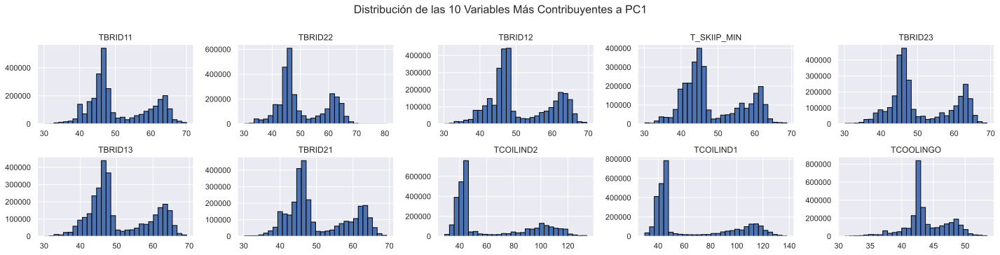

In [15]:
#PC1
#---
columnas_a_dibujar = ['TBRID11', 'TBRID22', 'TBRID12', 'T_SKIIP_MIN', 'TBRID23', 'TBRID13', 'TBRID21', 'TCOILIND2', 'TCOILIND1', 'TCOOLINGO']
# Ajustar el tamaño de la figura y la distribución de subgráficos
df_plots[columnas_a_dibujar].hist(figsize=(20, 20), bins=30, layout=(9, 5), edgecolor='black')

plt.tight_layout()  # Ajusta los espacios entre gráficos

plt.suptitle("Distribución de las 10 Variables Más Contribuyentes a PC1", fontsize=16, y=1.02)

# Guardar la figura
plt.savefig("/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/Imagenes/Analisis_PCA/Distribucion_Top10Variables_PC1.png", dpi=300)

#plt.show()

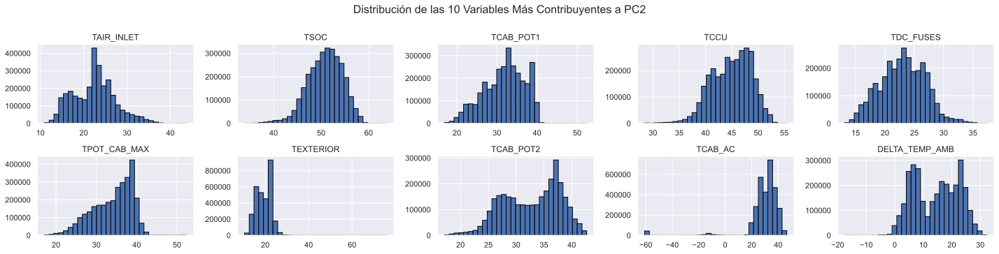

In [16]:
#PC2
#---
columnas_a_dibujar = ['TAIR_INLET', 'TSOC', 'TCAB_POT1', 'TCCU', 'TDC_FUSES', 'TPOT_CAB_MAX', 'TEXTERIOR', 'TCAB_POT2', 'TCAB_AC', 'DELTA_TEMP_AMB']
# Ajustar el tamaño de la figura y la distribución de subgráficos
df_plots[columnas_a_dibujar].hist(figsize=(20, 20), bins=30, layout=(9, 5), edgecolor='black')

plt.tight_layout()  # Ajusta los espacios entre gráficos

plt.suptitle("Distribución de las 10 Variables Más Contribuyentes a PC2", fontsize=16, y=1.02)

# Guardar la figura
plt.savefig("/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/Imagenes/Analisis_PCA/Distribucion_Top10Variables_PC2.png", dpi=300)

#plt.show()

#Podemos observar en la distribución de DELTA_TEMP_AMB que hay bastantes valores entre 0 y 10 y estas representan las situaciones en las que es
#necesario caldear los skiips


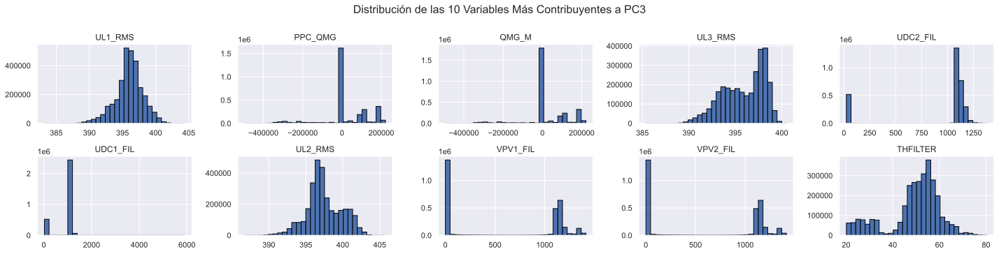

In [17]:
#PC3
#---
columnas_a_dibujar = ['UL1_RMS', 'PPC_QMG', 'QMG_M', 'UL3_RMS', 'UDC2_FIL', 'UDC1_FIL', 'UL2_RMS', 'VPV1_FIL', 'VPV2_FIL', 'THFILTER']
# Ajustar el tamaño de la figura y la distribución de subgráficos
df_plots[columnas_a_dibujar].hist(figsize=(20, 20), bins=30, layout=(9, 5), edgecolor='black')

plt.tight_layout()  # Ajusta los espacios entre gráficos

plt.suptitle("Distribución de las 10 Variables Más Contribuyentes a PC3", fontsize=16, y=1.02)

# Guardar la figura
plt.savefig("/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/Imagenes/Analisis_PCA/Distribucion_Top10Variables_PC3.png", dpi=300)

#plt.show()

#Observando las distribuciones de VPV1_FIL Y VPV2_FIL (representan el voltaje en los paneles) vemos como muchos de nuestros regstros tienen
#voltaje nulo(¿podrían ser situaciones de inactividad?)

### Matrices de correlación

In [18]:
def plot_correlacion_heatmap(df, columnas, titulo="Matriz de Correlación", guardar=False, ruta_guardado=None):
    """
    Genera un heatmap de correlación para las columnas especificadas de un DataFrame.

    Parámetros:
    - df: DataFrame con los datos
    - columnas: lista de nombres de columnas para calcular la correlación
    - titulo: título del gráfico
    - guardar: True si deseas guardar la imagen
    - ruta_guardado: ruta del archivo donde guardar la imagen (incluye .png)
    """
    # Subset del DataFrame
    df_subset = df[columnas]
    
    # Calcular matriz de correlación
    matriz_corr = df_subset.corr(method='pearson')
    
    # Calcular límites de colores dinámicamente
    vmin = matriz_corr.min().min()
    vmax = matriz_corr.max().max()

    # Crear el heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(matriz_corr, annot=True, fmt=".2f", cmap='coolwarm',
                vmin=vmin, vmax=vmax, linewidths=0.5, linecolor='gray', square=True, annot_kws={"size": 8})

    plt.title(titulo, fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    
    # Guardar si se solicita
    if guardar and ruta_guardado:
        plt.savefig(ruta_guardado, dpi=300, bbox_inches='tight')
    
    plt.show()


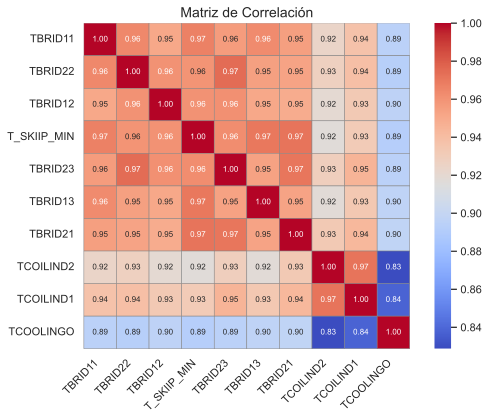

In [19]:
#PC1:
#----

cols1 = ['TBRID11', 'TBRID22', 'TBRID12', 'T_SKIIP_MIN', 'TBRID23', 'TBRID13', 'TBRID21', 'TCOILIND2', 'TCOILIND1', 'TCOOLINGO']
df_vars_pc1 = df_plots[cols1]
plot_correlacion_heatmap(df_vars_pc1, cols1, titulo="Matriz de Correlación", guardar=True, ruta_guardado='/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/Imagenes/Analisis_PCA/MatrizCorrelacion_PC1')

#Tenemos correlaciones linesales muy elevadas entre estas variables. Esto tiene sentido pues al hacer PCA se tienen en cuenta las variables con
#correlaciones lineales elevadas.

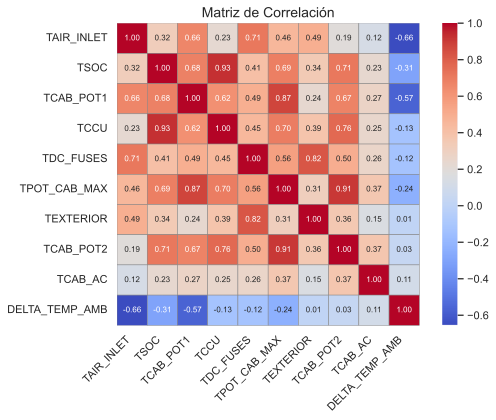

In [20]:
#PC2:
#----

cols2 = ['TAIR_INLET', 'TSOC', 'TCAB_POT1', 'TCCU', 'TDC_FUSES', 'TPOT_CAB_MAX', 'TEXTERIOR', 'TCAB_POT2', 'TCAB_AC', 'DELTA_TEMP_AMB']
df_vars_pc2 = df_plots[cols2]
plot_correlacion_heatmap(df_vars_pc2, cols2, titulo="Matriz de Correlación", guardar=True, ruta_guardado='/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/Imagenes/Analisis_PCA/MatrizCorrelacion_PC2')

#Seguimos eniendo correlaciones lineales elevadas y ahora aparecen correlaciones negativas. Sin embargo, las correlaciones ya no son tan 
#elevadas como en el caso de PC1

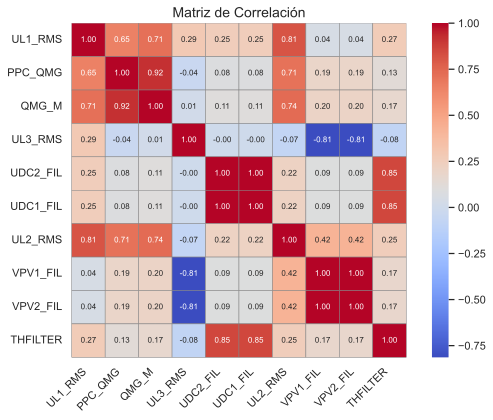

In [21]:
#PC3:
#----

cols3 = ['UL1_RMS', 'PPC_QMG', 'QMG_M', 'UL3_RMS', 'UDC2_FIL', 'UDC1_FIL', 'UL2_RMS', 'VPV1_FIL', 'VPV2_FIL', 'THFILTER']
df_vars_pc3 = df_plots[cols3]
plot_correlacion_heatmap(df_vars_pc3, cols3, titulo="Matriz de Correlación", guardar=True, ruta_guardado='/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/Imagenes/Analisis_PCA/MatrizCorrelacion_PC3')

#Tenemos algunas correlaciones elevadas tanto positivas como negativas pero la mayoríoa de correlaciones son menos fuertes.

### Evolución temporal de estas variables en inversores con comportamiento normal y anómalo

In [ ]:
#Vamos a plotear la evolución temporal de los inversores el día 13-02-25 en el que sabemos que esl inversor 11 tuvo un fallo de explosión
#tras congelar

In [2]:
lista_csv_plots_130225 = [
    "/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Datos_TFMGamesa/FalloExplosionTrasCongelarPruebas 13_02_25/inv34/plot_all_data_20250213_093223.csv",
    "/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Datos_TFMGamesa/FalloExplosionTrasCongelarPruebas 13_02_25/Inv33/plot_all_data_20250213_083840.csv",
    "/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Datos_TFMGamesa/FalloExplosionTrasCongelarPruebas 13_02_25/inv11/I11 plot_all_data_20250213_084442.csv",
    "/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Datos_TFMGamesa/FalloExplosionTrasCongelarPruebas 13_02_25/inv4/plot_all_data_20250213_083243.csv",
    "/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Datos_TFMGamesa/FalloExplosionTrasCongelarPruebas 13_02_25/INV2/plot_all_data_20250213_082705.csv"
]

csv_alarmas_130225 = "/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Datos_TFMGamesa/FalloExplosionTrasCongelarPruebas 13_02_25/inv11/alarms_register_20250213_084618.csv"

nombres_inversores_130225 = ["INV34", "INV33", "INV11", "INV4", "INV2"]

In [3]:
#Calculamos DELTA_TEMP_AMB para los csvs de plots

Codificación detectada: ISO-8859-1


/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  plots = pd.read_csv(nombre_csv, index_col = False, sep = ";")
/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  plots = pd.read_csv(nombre_csv, index_col = False, sep = ";")
/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  plots = pd.read_csv(nombre_csv, index_col = False, sep = ";")
/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/funciones_limpieza.py:124: ParserWarning: Length of header or names does not match len

Fecha mínima de los plots es 2025-02-12 08:25:33 y la fecha máxima es 2025-02-13 09:30:12


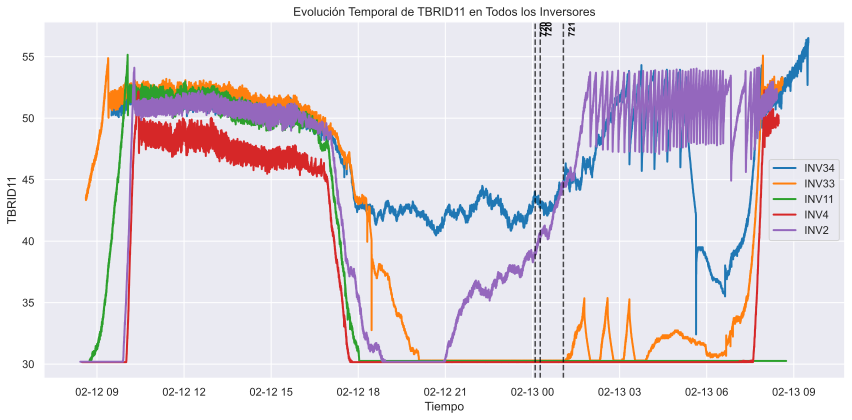

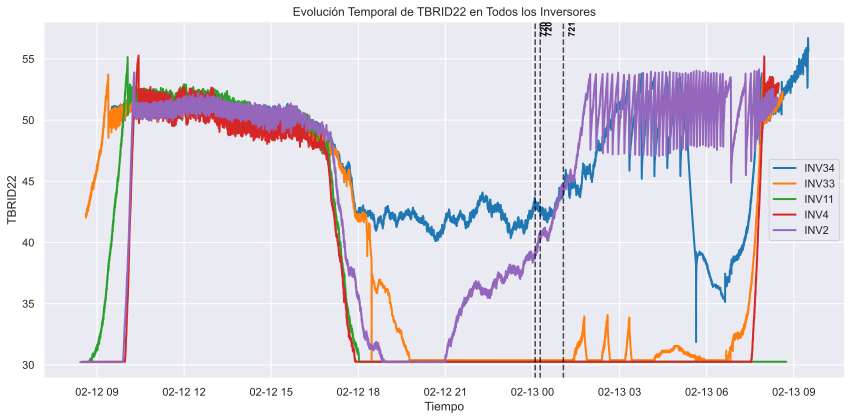

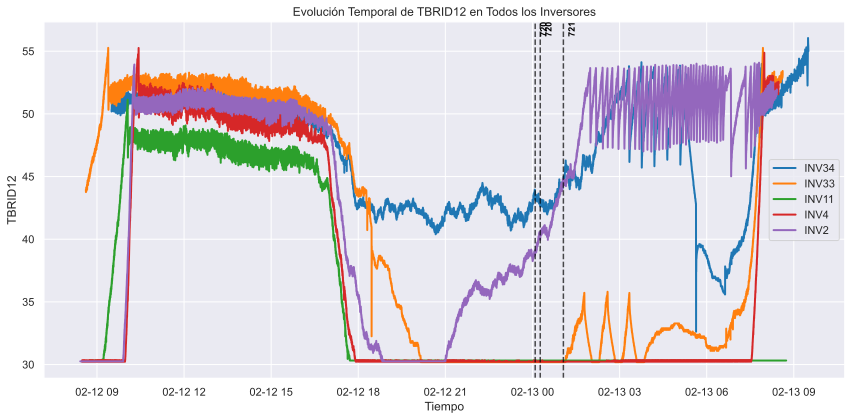

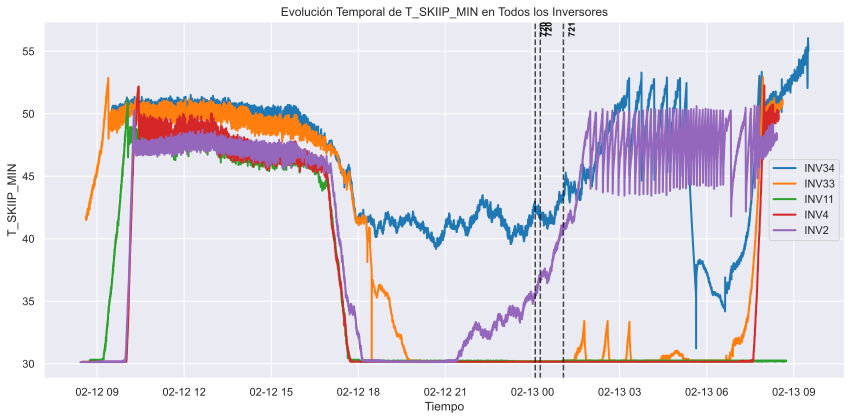

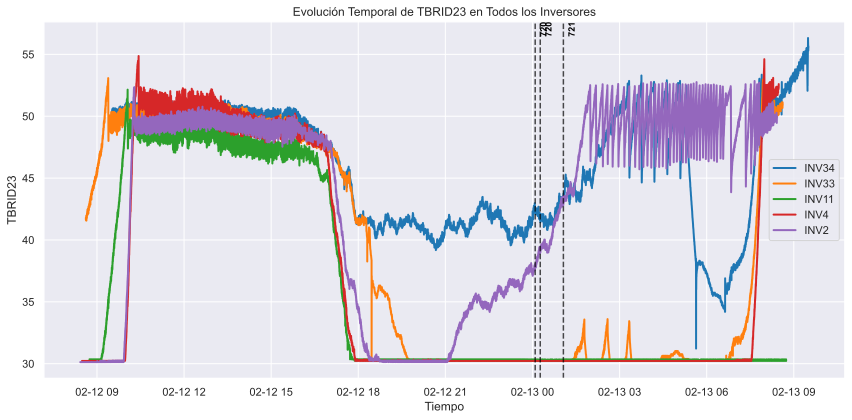

...

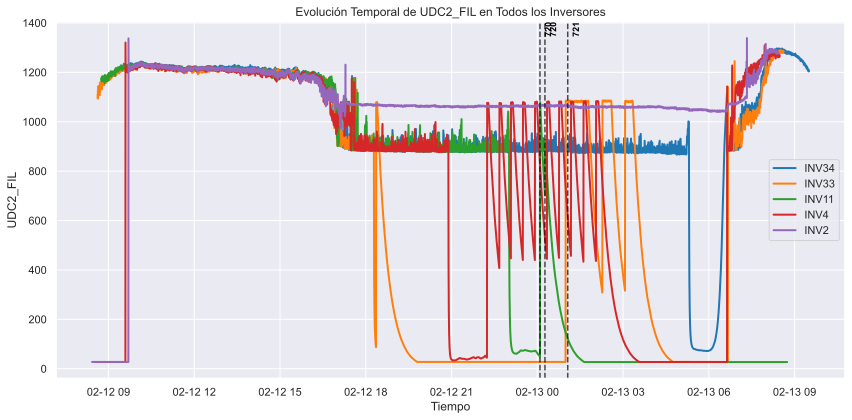

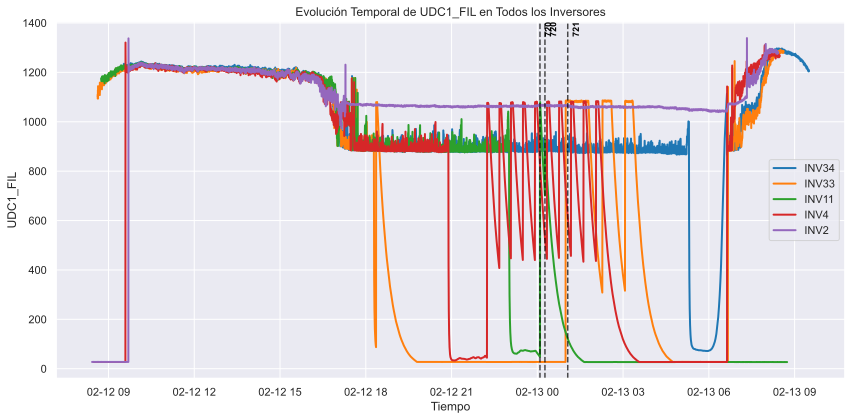

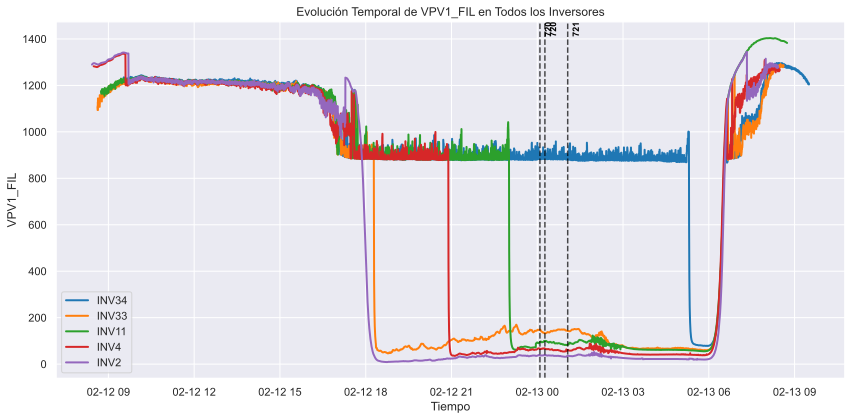

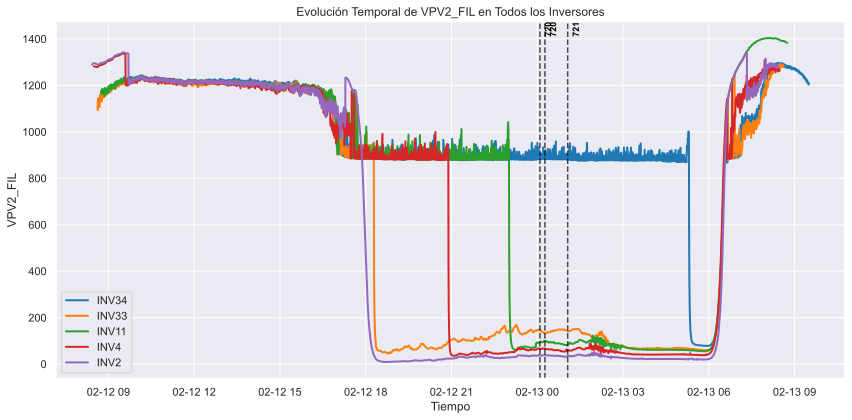

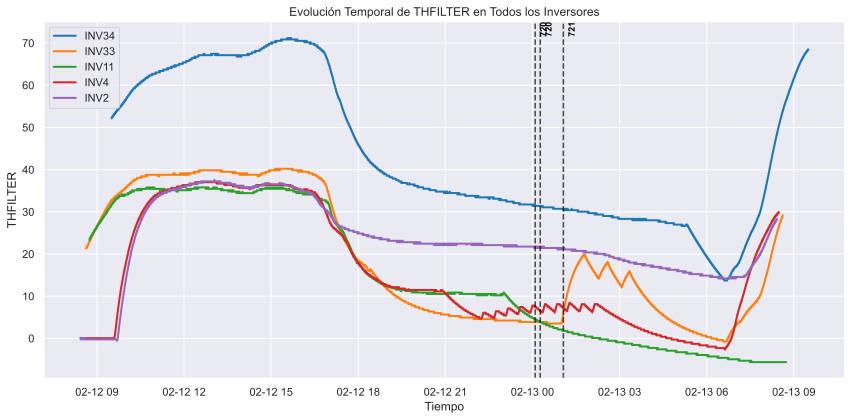

In [4]:
variables_a_graficar = ['TBRID11', 'TBRID22', 'TBRID12', 'T_SKIIP_MIN', 'TBRID23', 'TBRID13', 'TBRID21', 'TCOILIND2', 'TCOILIND1', 'TCOOLINGO',
                       'TAIR_INLET', 'TSOC', 'TCAB_POT1', 'TCCU', 'TDC_FUSES', 'TPOT_CAB_MAX', 'TEXTERIOR', 'TCAB_POT2', 'TCAB_AC', 'DELTA_TEMP_AMB',
                       'UL1_RMS', 'PPC_QMG', 'QMG_M', 'UL3_RMS', 'UDC2_FIL', 'UDC1_FIL', 'UL2_RMS', 'VPV1_FIL', 'VPV2_FIL', 'THFILTER']
alarmas_a_graficar = ['ALARM_720', 'ALARM_721'] #Hay una alarma que se llama ALARM_720_RE ¿La tengo en cuenta también?

alarmas_130225 = evolucion_temporal_variable_inversores(lista_csv_plots_130225,
                                                        csv_alarmas_130225,
                                                        nombres_inversores_130225,
                                                        '20250213',
                                                        variables_a_graficar,
                                                        alarmas_a_graficar,
                                                        '/Users/lucialopez/Documents/MBD/Segundo_cuatrimestre/TFM/Clustering/Imagenes/Analisis_PCA')

#Observando la evolución temporal de la variable DELT_TEMP_AMB vemos que el inversor 11 ha tenido valores negativos lo que indica fallo por
#condensación (justo después de la apariciión de las alarmas 720 y 721)